#Assignment 3 - Part 1



Install dependencies

In [ ]:
!sudo apt update

!pip install swig
!pip install box2d-py
!pip install gymnasium[box2d]
!pip install torchview
!pip install tensorboard



Hit:1 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:2 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [119 kB]
Hit:3 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Hit:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Get:5 http://security.ubuntu.com/ubuntu jammy-security InRelease [110 kB]
Get:6 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Hit:7 https://ppa.launchpadcontent.net/c2d4u.team/c2d4u4.0+/ubuntu jammy InRelease
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:11 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 Packages [1,305 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 Packages [1,599 kB]
Get:13 http://security.ubuntu.com/ubuntu jammy-security/univers

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


##Imports

Randomize True for Training?


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import time
from matplotlib.pyplot import figure

import gymnasium as gym
import torch
from torch.utils import data
import torch.nn as nn
import torch.optim as optim
import torch.autograd as autograd
import random
from gymnasium import wrappers
import copy
from gymnasium.wrappers.record_video import RecordVideo

import glob
import io
import base64
from IPython.display import HTML
from IPython import display as ipythondisplay

import torchvision
from torchview import draw_graph
from torch.utils.tensorboard import SummaryWriter

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')


###################################################
###################################################
###################################################
UseRandomize=False;
UseContinuousControl=False;
###################################################
###################################################
###################################################



Deep RL Replay Buffer

In [ ]:
class ReplayBuffer:
    def __init__(self, size):
        self.size = size
        self.counter = 0
        self.state_buffer = []
        self.action_buffer = []
        self.reward_buffer = []
        self.new_state_buffer = []
        self.terminal_buffer = []

    def store_tuples(self, state, action, reward, new_state, done):
        if len(self.state_buffer) < self.size:
            self.state_buffer.append(None)
            self.action_buffer.append(None)
            self.reward_buffer.append(None)
            self.new_state_buffer.append(None)
            self.terminal_buffer.append(None)

        self.counter = self.counter % self.size
        self.state_buffer[self.counter] = state
        self.action_buffer[self.counter] = action
        self.reward_buffer[self.counter] = reward
        self.new_state_buffer[self.counter] = new_state
        self.terminal_buffer[self.counter] = done
        self.counter += 1

    def sample_buffer(self, batch_size):
        max_buffer = min(self.counter, self.size)
        batch = np.random.choice(max_buffer, batch_size, replace=False)
        state_batch=[];
        action_batch=[];
        reward_batch=[];
        new_state_batch=[];
        done_batch=[];

        for a in batch:
            state_batch.append(self.state_buffer[a])
            action_batch.append(self.action_buffer[a])
            reward_batch.append(self.reward_buffer[a])
            new_state_batch.append(self.new_state_buffer[a])
            done_batch.append(self.terminal_buffer[a])
        return state_batch, action_batch, reward_batch, new_state_batch, done_batch





Default DQN arquitecture

In [ ]:
from torchvision import datasets, models
class DQN(nn.Module):

    def __init__(self, inputs, outputs):
        super(DQN, self).__init__()

        self.input_size=inputs;
        self.output_size=outputs;

        self.features =nn.Sequential(  # input shape (4, 96, 96)
            nn.Conv2d(inputs, 8, kernel_size=4, stride=2),
            nn.ReLU(),  # activation
            nn.Conv2d(8, 16, kernel_size=3, stride=2),  # (8, 47, 47)
            nn.ReLU(),  # activation
            nn.Conv2d(16, 32, kernel_size=3, stride=2),  # (16, 23, 23)
            nn.ReLU(),  # activation
            nn.Conv2d(32, 64, kernel_size=3, stride=2),  # (32, 11, 11)
            nn.ReLU(),  # activation
            nn.Conv2d(64, 128, kernel_size=3, stride=1),  # (64, 5, 5)
            nn.ReLU(),  # activation
            nn.Conv2d(128, 256, kernel_size=3, stride=1),  # (128, 3, 3)
            nn.ReLU(),  # activation
        )  # output shape (256, 1, 1)

        self.layers =nn.Sequential(nn.Linear(256, 128), nn.ReLU(), nn.Linear(128, outputs))

        self.layersdueling =nn.Sequential(nn.Linear(256, 128), nn.ReLU())

        self.advantage =nn.Sequential(nn.Linear(128, 64), nn.ReLU(), nn.Linear(64, outputs))

        self.value =nn.Sequential(nn.Linear(128,64),nn.ReLU(), nn.Linear(64,1))

###### DQN/Double DQN configuration

###########    ############    #################
#         #    #          #    #               #
#   IMG   # -> # features # -> #     layers    #    .... argmax ....
#         #    #  (CONVs) #    #     (FCs)     #
###########    ############    #################


###### Dueling configuration
                                                    #############
###########    ############    #################    # advantage #
#         #    #          #    #               # -> #############   ... value + advantage  - advantage.mean() ... argmax ...
#   IMG   # -> # features # -> # layersdueling # -> #############
#         #    #  (CONVs) #    #     (FCs)     #    #   value   #
###########    ############    #################    #############


    def forward(self, x):

        if(useDueling):
            x=self.features(x)
            x = x.view(x.size(0), -1)
            x = self.layersdueling(x)
            advantage = self.advantage(x)
            value     = self.value(x)
            return value + advantage  - advantage.mean()
        else:
            x=self.features(x)
            x = x.view(x.size(0), -1)
            return self.layers(x)

    def policy(self,state):
       with torch.no_grad():
            return self.__call__(state.unsqueeze(0)).argmax()

    def getPolicy(self,state,eps_threshold):
        sample = random.random()
        if sample > eps_threshold:
            with torch.no_grad():
                return self.__call__(state.unsqueeze(0)).argmax()
        else:
            return  torch.tensor(random.randrange(self.output_size), device=device, dtype=torch.long)


OpenAI Environment CarRacing-v2


###    Description:
        Continuous or discrete control task to learn from pixels, a top-down racing environment.
###    Observation:
        Type: Image (96x96x3)
        Some indicators are shown at the bottom of the window along with the state RGB buffer. From left to right: the true speed, four ABS sensors, the steering wheel position and gyroscope.
###    Actions:
        Discrete Mode: 'nothing','left','right','gas','brake'
        Continuous Mode: 3 different variables can be modified: steering wheel, gas, and brake. For the methods explored in this Colab, discrete control commands are reasonable (a set of control commands is provided for this mode).
###    Reward:
        The reward is -0.1 every frame and +1000/N for every track tile visited, where N is the total number of tiles visited in the track. For example, if you have finished in 732 frames, your reward is 1000 - 0.1*732 = 926.8 points.
###    Starting State:
        The tracks and colors are randomly generated with UseRandomize=True for each episode. With UseRandomize=False, only the tracks are random.
###    Episode Termination:
        Car is too faraway from the track.
        Car accumulated a negative reward after given iterations (see ResetCounter and InitCounter).
        Episode length is greater than 1000.
        All tiles are visited.
###     Solved Requirements:
        The game is solved when the agent consistently gets 900+ points. For this assignment a minimum of 200 points are required.


DQN movie generation (for visual evaluation in Google Colab)

In [ ]:

def createMovie(Network,Filename,UseRandomizer,UseContinuous):

    env1 = gym.make("CarRacing-v2", render_mode="rgb_array",domain_randomize=UseRandomizer, continuous=UseContinuous)
    envX = env1#wrappers.Monitor(env1, './videos/'+Filename,force=True)
    envX = RecordVideo(env1, video_folder='./videos/'+Filename,  episode_trigger = lambda episode_number: True)


    new_state = envX.reset(options={"randomize": UseRandomizer})#,seed=6)

    envX.start_video_recorder()
    # ENV BUG, missing last_frame
    envX.video_recorder.last_frame=new_state[0];


    stackedStateX=[np.rollaxis(new_state[0], 2, 0).copy() for i in range(FrameStack)];
    state =torch.from_numpy(np.reshape(np.array(stackedStateX),(FrameSize*FrameStack,96,96)) ).float().to(device)


    i=0
    Network.eval()
    resetStatus=0;


    while True:
        envX.render()

        action = Network.policy(state);
        reward=0
        for x in range(ControlSteps):
            new_state, r, done, truncated, _  = envX.step(action_space[action.item()])
            reward+=r
            if(done):
                break

        stackedStateX.pop(0)

        stackedStateX.append(np.rollaxis(new_state, 2, 0).copy())
        state=torch.from_numpy(np.reshape(np.array(stackedStateX),(FrameSize*FrameStack,96,96))).float().to(device)
        i=i+1;
        if done or truncated:
          break;

    envX.close()
    env1.close();
    Network.train()
    mp4list = glob.glob('./videos/'+Filename+'/*.mp4')
    if len(mp4list) > 0:
        mp4 = mp4list[0]
        video = io.open(mp4, 'r+b').read()
        encoded = base64.b64encode(video)
        ipythondisplay.display(HTML(data='''<video alt="test" autoplay
                loop controls style="height: 400px;">
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii'))))
    else:
        print("Could not find video")

Dummy Net with random policy

In [ ]:
class RandomNet(nn.Module):

    def __init__(self,outputs):
        super(RandomNet, self).__init__()
        self.output_size=outputs;


    def forward(self, x):
        return  x

    def policy(self,state):
       return  torch.tensor([[random.randrange(self.output_size)]], device=device, dtype=torch.long)


Parameters

In [ ]:
if UseContinuousControl:
    #action space is still discretized however more actions can be selected
    action_space    = [
            (-1, 1, 0.2), (0, 1, 0.2), (1, 1, 0.2), #           Action Space Structure
            (-1, 1,   0), (0, 1,   0), (1, 1,   0), #        (Steering Wheel, Gas, Break)
            (-1, 0, 0.2), (0, 0, 0.2), (1, 0, 0.2), # Range        -1~1       0~1   0~1
            (-1, 0,   0), (0, 0,   0), (1, 0,   0)];

else:
    action_space=[0,1,2,3,4]    #  nothing','left','right','gas','brake'


n_actions=len(action_space)

#hyper-parameters
TotalEpisodes=500;
MaxSteps=1000;
ControlSteps=3; # number of iterations the same action is executed in the environment
FrameStack=5 # number of consecutive frames used to represent the state
FreezeCounter=5; # clone the model every X episodes
BatchSize=64;
exploration_threshold=1
exploration_threshold_min=0.01
exploration_decay=0.985
discount_factor=0.95
LearningRate=0.0001

SaveAtCounter=50 # save model or video at every X episodes
ResetCounter=30 # maximum number of experiences with bad performance (max=InitCounter+ResetCounter)
InitCounter=30 # minimum number of experiences per episode
FrameSize=3; # 3 if RGB 1 if grayscale

BufferSize=15000  # max number of experiences in the buffer (may need to be smaller if CUDA memory errors occur).


# use these flags to enable Double DQN and Duelinng (Dueling DQN or Double Dueling DQN)
usedoubleDQN=True
useDueling=True



Run the new netwwork with random policy

In [ ]:
randomnet=RandomNet(n_actions)
createMovie(randomnet,"random",UseRandomize,UseContinuousControl)

Moviepy - Building video /content/videos/random/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/random/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/random/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/random/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/random/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/random/rl-video-episode-0.mp4


Initialization and Parameters:


In [ ]:
env = gym.make("CarRacing-v2", render_mode="rgb_array",domain_randomize=UseRandomize, continuous=UseContinuousControl)
spec = gym.spec("CarRacing-v2")

useDueling
#network DQN
policy_net = DQN(FrameSize*FrameStack, n_actions).to(device)
target_net = DQN(FrameSize*FrameStack, n_actions).to(device)
target_net.load_state_dict(policy_net.state_dict())
target_net.eval()

buffer = ReplayBuffer(BufferSize);

optimizer = torch.optim.Adam(policy_net.parameters(), lr=LearningRate)

loss=  torch.nn.SmoothL1Loss()


## Print the Architecture

In [ ]:
from torchsummary import summary

summary(policy_net, input_size=(15, 96, 96))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1            [-1, 8, 47, 47]           1,928
              ReLU-2            [-1, 8, 47, 47]               0
            Conv2d-3           [-1, 16, 23, 23]           1,168
              ReLU-4           [-1, 16, 23, 23]               0
            Conv2d-5           [-1, 32, 11, 11]           4,640
              ReLU-6           [-1, 32, 11, 11]               0
            Conv2d-7             [-1, 64, 5, 5]          18,496
              ReLU-8             [-1, 64, 5, 5]               0
            Conv2d-9            [-1, 128, 3, 3]          73,856
             ReLU-10            [-1, 128, 3, 3]               0
           Conv2d-11            [-1, 256, 1, 1]         295,168
             ReLU-12            [-1, 256, 1, 1]               0
           Linear-13                  [-1, 128]          32,896
             ReLU-14                  [

In [ ]:
import os
print(os.path.exists('logs'))

True


In [ ]:
writer = SummaryWriter(log_dir='logs')
dummy_input = torch.randn(1, 15, 96, 96).to(device)

writer.add_graph(policy_net, dummy_input)
writer.close()

In [ ]:
%tensorboard --logdir=logs

Reusing TensorBoard on port 6006 (pid 2894), started 0:03:08 ago. (Use '!kill 2894' to kill it.)

<IPython.core.display.Javascript object>

DQN training

In [ ]:
def trainModel(buffer_data, usedoubleDQN):
    if buffer_data.counter < BatchSize:
        return 0.0

    state_batch, action_batch, reward_batch, new_state_batch, done_batch = buffer_data.sample_buffer(BatchSize)
    state_batch = torch.stack(state_batch).to(device)
    action_batch = torch.stack(action_batch).reshape(-1,1).to(device)
    new_state_batch = torch.stack(new_state_batch).to(device)
    reward_batch = torch.stack(reward_batch).reshape(-1,1).to(device)
    done_batch = torch.stack(done_batch).reshape(-1,1).to(device)


    if usedoubleDQN:

        with torch.no_grad():
            # Get the best actions from the policy network for the new states
            best_actions = policy_net(new_state_batch).argmax(dim=1, keepdim=True)
            # Compute Q values for the best actions using the target network
            q_targets_next = target_net(new_state_batch).gather(1, best_actions).detach()

        q_actual = torch.gather(policy_net(state_batch), 1, index=action_batch)

        # Compute the Q target using Double DQN formula
        q_target = reward_batch + (discount_factor * q_targets_next) * (1 - done_batch)

        ll = loss(q_actual, q_target)

    else:
        q_actual = torch.gather(policy_net(state_batch),1,index=action_batch)
        with torch.no_grad():
            q_max_next, _ = target_net(new_state_batch).max(dim=1)
            q_max_next=q_max_next.reshape(-1, 1)

        q_target = (q_max_next * discount_factor)*(1-done_batch) + reward_batch

        ll=loss(q_actual, q_target)

    optimizer.zero_grad()
    ll.backward()
    torch.nn.utils.clip_grad_norm_(policy_net.parameters(), 1)
    optimizer.step()

    return ll.item();

#Last Train Dueling DoubleDQN or? not sure if Dueling True is passed

In [ ]:
loss_val,scores, episodes,events, avg_scores,avg_scores20,exploration = [],[],[], [],[], [], []

bestScore=-99999;
at=0;
bestNet=copy.deepcopy(policy_net);


for f in range(TotalEpisodes):
    done  = False
    score = 0.0
    tloss = 0.0

    new_state,_=env.reset(options={"randomize": UseRandomize})#,seed=6)


    stackedState=[np.rollaxis(new_state, 2, 0).copy() for i in range(FrameStack)];
    state =torch.from_numpy(np.reshape(np.array(stackedState),(FrameSize*FrameStack,96,96)) ).float().to(device)

    if f % FreezeCounter == 0:
       print("########################################"+str(f)+" of "+str(TotalEpisodes))
       target_net.load_state_dict(policy_net.state_dict())

    if f % SaveAtCounter == 0:
      #torch.save(policy_net.state_dict(), "v2CarRacing_"+str(f)+'_model.ckpt')
       createMovie(policy_net,"CarRacing_"+str(f),UseRandomize,UseContinuousControl)

    resetStatus=0;
    i=0

    for F in range(MaxSteps):
        action = policy_net.getPolicy(state,exploration_threshold)
        reward=0
        for _ in range(ControlSteps):
            new_state, r, done,trunc, info = env.step(action_space[action.item()])
            reward+=r
            i=i+1
            if(done or trunc):
                break
        if reward<0 and i>InitCounter:
            resetStatus=resetStatus+1;
        else:
            resetStatus=0

        stackedState.pop(0)
        stackedState.append(np.rollaxis(new_state, 2, 0).copy())
        new_state=torch.from_numpy(np.reshape(np.array(stackedState),(FrameSize*FrameStack,96,96))).float().to(device)

        score += reward
        if(F<(MaxSteps-1)):
            buffer.store_tuples(state, action, torch.tensor(reward), new_state, torch.tensor(int(done)))

        state = new_state
        trainModel(buffer, usedoubleDQN)


        if(done or trunc or resetStatus>=ResetCounter):
            break
    exploration_threshold= exploration_threshold*exploration_decay if exploration_threshold > exploration_threshold_min else exploration_threshold_min

    if(score>bestScore):
        print("Best EP: ",score," It: ",F*ControlSteps)
        bestScore=score;
        bestNet=copy.deepcopy(policy_net);
        at=f;

    exploration.append(exploration_threshold)
    scores.append(score)
    episodes.append(f)
    events.append(F)
    avg_scores.append(score/F)
    avg_scores20.append(np.mean(scores[-20:]))


torch.save(bestNet.state_dict(), "BestCarRacing_"+str(f)+'_'+str(bestScore)+'_model.ckpt')

########################################0 of 500
Moviepy - Building video /content/videos/CarRacing_0/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_0/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_0/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_0/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_0/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_0/rl-video-episode-0.mp4


Best EP:  -2.0918367346938522  It:  222
Best EP:  6.557046979865865  It:  267
########################################5 of 500
########################################10 of 500
Best EP:  10.876706827309256  It:  330
########################################15 of 500
########################################20 of 500
########################################25 of 500
########################################30 of 500
Best EP:  14.868702290076062  It:  459
########################################35 of 500
Best EP:  47.07259786476801  It:  843
########################################40 of 500
########################################45 of 500
Best EP:  51.66037735849  It:  537
########################################50 of 500
Moviepy - Building video /content/videos/CarRacing_50/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_50/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_50/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_50/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_50/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_50/rl-video-episode-0.mp4


########################################55 of 500
########################################60 of 500
Best EP:  85.54368231046995  It:  369
########################################65 of 500
Best EP:  87.23750000000148  It:  609
########################################70 of 500
Best EP:  153.2282282282314  It:  747
Best EP:  201.52671755725683  It:  999
########################################75 of 500
Best EP:  205.7553956834561  It:  999
########################################80 of 500
########################################85 of 500
########################################90 of 500
########################################95 of 500
Best EP:  261.6664233576647  It:  738
########################################100 of 500
Moviepy - Building video /content/videos/CarRacing_100/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_100/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_100/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_100/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_100/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_100/rl-video-episode-0.mp4


Best EP:  335.4300395256877  It:  951
########################################105 of 500
########################################110 of 500
########################################115 of 500
########################################120 of 500
Best EP:  508.2474226804019  It:  999
########################################125 of 500
########################################130 of 500
########################################135 of 500
Best EP:  565.4135338345752  It:  999
########################################140 of 500
Best EP:  691.5057915057752  It:  999
########################################145 of 500
########################################150 of 500
Moviepy - Building video /content/videos/CarRacing_150/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_150/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_150/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_150/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_150/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_150/rl-video-episode-0.mp4


########################################155 of 500
########################################160 of 500
########################################165 of 500
Best EP:  705.1470588235153  It:  999
########################################170 of 500
Best EP:  821.9858156028264  It:  999
########################################175 of 500
########################################180 of 500
########################################185 of 500
Best EP:  852.0547945205313  It:  999
Best EP:  863.3020408163113  It:  915
########################################190 of 500
########################################195 of 500
########################################200 of 500
Moviepy - Building video /content/videos/CarRacing_200/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_200/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_200/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_200/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_200/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_200/rl-video-episode-0.mp4


########################################205 of 500
Best EP:  904.3999999999826  It:  954
Best EP:  905.2999999999918  It:  945
########################################210 of 500
########################################215 of 500
########################################220 of 500
########################################225 of 500
########################################230 of 500
########################################235 of 500
Best EP:  905.5999999999835  It:  942
########################################240 of 500
Best EP:  910.3999999999861  It:  894
########################################245 of 500
Best EP:  910.6999999999865  It:  891
########################################250 of 500
Moviepy - Building video /content/videos/CarRacing_250/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_250/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_250/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_250/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_250/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_250/rl-video-episode-0.mp4


########################################255 of 500
Best EP:  911.1999999999858  It:  885
Best EP:  913.4999999999916  It:  864
########################################260 of 500
Best EP:  914.8999999999905  It:  849
########################################265 of 500
########################################270 of 500
Best EP:  922.0999999999904  It:  777
########################################275 of 500
########################################280 of 500
########################################285 of 500
########################################290 of 500
########################################295 of 500
Best EP:  924.3999999999943  It:  753
########################################300 of 500
Moviepy - Building video /content/videos/CarRacing_300/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_300/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_300/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_300/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_300/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_300/rl-video-episode-0.mp4


########################################305 of 500
########################################310 of 500
########################################315 of 500
########################################320 of 500
########################################325 of 500
########################################330 of 500
Best EP:  928.6999999999924  It:  711
########################################335 of 500
########################################340 of 500
########################################345 of 500
########################################350 of 500
Moviepy - Building video /content/videos/CarRacing_350/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_350/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_350/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_350/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_350/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_350/rl-video-episode-0.mp4


########################################355 of 500
########################################360 of 500
########################################365 of 500
########################################370 of 500
########################################375 of 500
Best EP:  931.299999999993  It:  684
########################################380 of 500
########################################385 of 500
########################################390 of 500
########################################395 of 500
########################################400 of 500
Moviepy - Building video /content/videos/CarRacing_400/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_400/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_400/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_400/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_400/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_400/rl-video-episode-0.mp4


########################################405 of 500
########################################410 of 500
########################################415 of 500
########################################420 of 500
########################################425 of 500
########################################430 of 500
########################################435 of 500
########################################440 of 500
Best EP:  931.799999999993  It:  681
########################################445 of 500
########################################450 of 500
Moviepy - Building video /content/videos/CarRacing_450/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_450/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_450/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_450/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_450/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_450/rl-video-episode-0.mp4


########################################455 of 500
########################################460 of 500
########################################465 of 500
########################################470 of 500
########################################475 of 500
########################################480 of 500
########################################485 of 500
########################################490 of 500
########################################495 of 500


Plot performance

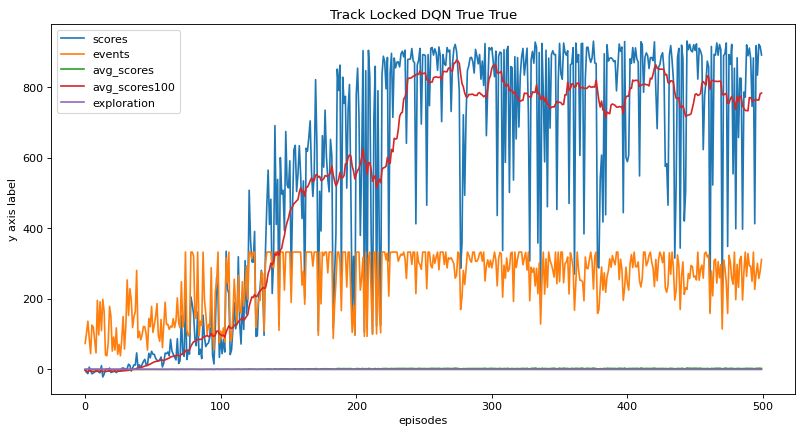

In [ ]:
figure(figsize=(12, 6), dpi=80)
plt.plot(episodes, scores)
plt.plot(episodes, events)
plt.plot(episodes, avg_scores)
plt.plot(episodes, avg_scores20)
plt.plot(episodes, exploration)
plt.xlabel('episodes')
plt.ylabel('y axis label')

plt.title('Track Locked DQN '+str(usedoubleDQN)+' '+str(useDueling))
plt.legend(['scores', 'events', 'avg_scores', 'avg_scores100','exploration'])
plt.show()

View Best Results

In [ ]:
createMovie(bestNet,'bestNet',UseRandomize,UseContinuousControl)




Moviepy - Building video /content/videos/bestNet/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/bestNet/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/bestNet/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/bestNet/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/bestNet/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/bestNet/rl-video-episode-0.mp4


In [ ]:
def evaluate(Network,Filename,UseRandomizer,UseContinuous):

    env1 = gym.make("CarRacing-v2", render_mode="rgb_array",domain_randomize=UseRandomizer, continuous=UseContinuous)
    envX = env1

    #new_state = envX.reset(options={"randomize": UseRandomizer})#,seed=6)

    new_state, _ = envX.reset(options={"randomize": UseRandomizer})#,seed=6)


    stackedStateX=[np.rollaxis(new_state, 2, 0).copy() for i in range(FrameStack)];
    state =torch.from_numpy(np.reshape(np.array(stackedStateX),(FrameSize*FrameStack,96,96)) ).float().to(device)


    i=0
    Network.eval()
    resetStatus=0;

    totalreward=0
    while True:
        action = Network.policy(state);
        reward=0
        for x in range(ControlSteps):
            new_state, r, done, truncated, _  = envX.step(action_space[action.item()])
            reward+=r
            if(done):
                break

        totalreward+=reward;
        stackedStateX.pop(0)


        stackedStateX.append(np.rollaxis(new_state, 2, 0).copy())
        state=torch.from_numpy(np.reshape(np.array(stackedStateX),(FrameSize*FrameStack,96,96))).float().to(device)
        i=i+1;
        if done or truncated:
          break;

    envX.close()
    return totalreward;

In [ ]:
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))


878.5985865724209
492.5152317880664
927.0999999999965
921.6999999999846
885.8627177700193
141.52185430463916
95.23973941368557
281.6897637795295
212.72517006802437
-94.25897435897438


##DQN Training without Dueling

In [ ]:
usedoubleDQN=False
useDueling=False

loss_val,scores, episodes,events, avg_scores,avg_scores20,exploration = [],[],[], [],[], [], []

bestScore=-99999;
at=0;
bestNet=copy.deepcopy(policy_net);


for f in range(TotalEpisodes):
    done  = False
    score = 0.0
    tloss = 0.0

    new_state,_=env.reset(options={"randomize": UseRandomize})#,seed=6)


    stackedState=[np.rollaxis(new_state, 2, 0).copy() for i in range(FrameStack)];
    state =torch.from_numpy(np.reshape(np.array(stackedState),(FrameSize*FrameStack,96,96)) ).float().to(device)

    if f % FreezeCounter == 0:
       print("########################################"+str(f)+" of "+str(TotalEpisodes))
       target_net.load_state_dict(policy_net.state_dict())

    if f % SaveAtCounter == 0:
      #torch.save(policy_net.state_dict(), "v2CarRacing_"+str(f)+'_model.ckpt')
       createMovie(policy_net,"CarRacing_"+str(f),UseRandomize,UseContinuousControl)

    resetStatus=0;
    i=0

    for F in range(MaxSteps):
        action = policy_net.getPolicy(state,exploration_threshold)
        reward=0
        for _ in range(ControlSteps):
            new_state, r, done,trunc, info = env.step(action_space[action.item()])
            reward+=r
            i=i+1
            if(done or trunc):
                break
        if reward<0 and i>InitCounter:
            resetStatus=resetStatus+1;
        else:
            resetStatus=0

        stackedState.pop(0)
        stackedState.append(np.rollaxis(new_state, 2, 0).copy())
        new_state=torch.from_numpy(np.reshape(np.array(stackedState),(FrameSize*FrameStack,96,96))).float().to(device)

        score += reward
        if(F<(MaxSteps-1)):
            buffer.store_tuples(state, action, torch.tensor(reward), new_state, torch.tensor(int(done)))

        state = new_state
        trainModel(buffer, usedoubleDQN)


        if(done or trunc or resetStatus>=ResetCounter):
            break
    exploration_threshold= exploration_threshold*exploration_decay if exploration_threshold > exploration_threshold_min else exploration_threshold_min

    if(score>bestScore):
        print("Best EP: ",score," It: ",F*ControlSteps)
        bestScore=score;
        bestNet=copy.deepcopy(policy_net);
        at=f;

    exploration.append(exploration_threshold)
    scores.append(score)
    episodes.append(f)
    events.append(F)
    avg_scores.append(score/F)
    avg_scores20.append(np.mean(scores[-20:]))


torch.save(bestNet.state_dict(), "BestCarRacing_"+str(f)+'_'+str(bestScore)+'_model.ckpt')

########################################0 of 500
Moviepy - Building video /content/videos/CarRacing_0/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_0/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_0/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_0/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_0/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_0/rl-video-episode-0.mp4


Best EP:  0.5679245283019237  It:  180
########################################5 of 500
Best EP:  3.1114068441065164  It:  156
########################################10 of 500
########################################15 of 500
Best EP:  6.314035087719422  It:  390
########################################20 of 500
Best EP:  6.5275261324042315  It:  315
Best EP:  16.08373702422123  It:  459
########################################25 of 500
Best EP:  23.389189189188862  It:  405
########################################30 of 500
Best EP:  41.34444444444352  It:  903
########################################35 of 500
########################################40 of 500
########################################45 of 500
########################################50 of 500
Moviepy - Building video /content/videos/CarRacing_50/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_50/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_50/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_50/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_50/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_50/rl-video-episode-0.mp4


########################################55 of 500
########################################60 of 500
########################################65 of 500
Best EP:  46.52631578947333  It:  387
########################################70 of 500
Best EP:  64.33455149501697  It:  450
########################################75 of 500
########################################80 of 500
Best EP:  167.60563380282056  It:  999
########################################85 of 500
########################################90 of 500
Best EP:  361.02992125983945  It:  993
########################################95 of 500
########################################100 of 500
Moviepy - Building video /content/videos/CarRacing_100/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_100/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_100/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_100/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_100/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_100/rl-video-episode-0.mp4


########################################105 of 500
Best EP:  384.7457627118592  It:  999
########################################110 of 500
########################################115 of 500
Best EP:  449.99999999999415  It:  999
########################################120 of 500
########################################125 of 500
Best EP:  509.7560975609636  It:  999
########################################130 of 500
########################################135 of 500
Best EP:  597.1830985915394  It:  999
########################################140 of 500
########################################145 of 500
########################################150 of 500
Moviepy - Building video /content/videos/CarRacing_150/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_150/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_150/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_150/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_150/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_150/rl-video-episode-0.mp4


Best EP:  667.7165354330625  It:  999
########################################155 of 500
########################################160 of 500
Best EP:  699.2424242424107  It:  999
########################################165 of 500
Best EP:  837.9562043795472  It:  999
########################################170 of 500
########################################175 of 500
########################################180 of 500
########################################185 of 500
Best EP:  840.5561643835454  It:  975
########################################190 of 500
Best EP:  892.7007299269898  It:  999
########################################195 of 500
########################################200 of 500
Moviepy - Building video /content/videos/CarRacing_200/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_200/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_200/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_200/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_200/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_200/rl-video-episode-0.mp4


Best EP:  893.3110367892788  It:  999
########################################205 of 500
Best EP:  901.199999999984  It:  987
Best EP:  909.0999999999901  It:  906
########################################210 of 500
Best EP:  912.6999999999837  It:  870
########################################215 of 500
########################################220 of 500
########################################225 of 500
########################################230 of 500
########################################235 of 500
########################################240 of 500
########################################245 of 500
########################################250 of 500
Moviepy - Building video /content/videos/CarRacing_250/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_250/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_250/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_250/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_250/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_250/rl-video-episode-0.mp4


########################################255 of 500
########################################260 of 500
########################################265 of 500
########################################270 of 500
########################################275 of 500
########################################280 of 500
########################################285 of 500
Best EP:  921.499999999995  It:  783
########################################290 of 500
########################################295 of 500
########################################300 of 500
Moviepy - Building video /content/videos/CarRacing_300/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_300/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_300/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_300/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_300/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_300/rl-video-episode-0.mp4


########################################305 of 500
Best EP:  926.4999999999945  It:  732
########################################310 of 500
########################################315 of 500
########################################320 of 500
########################################325 of 500
########################################330 of 500
########################################335 of 500
########################################340 of 500
Best EP:  927.4999999999959  It:  723
########################################345 of 500
########################################350 of 500
Moviepy - Building video /content/videos/CarRacing_350/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_350/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_350/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_350/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_350/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_350/rl-video-episode-0.mp4


########################################355 of 500
Best EP:  930.0999999999867  It:  696
########################################360 of 500
########################################365 of 500
########################################370 of 500
########################################375 of 500
########################################380 of 500
########################################385 of 500
########################################390 of 500
########################################395 of 500
########################################400 of 500
Moviepy - Building video /content/videos/CarRacing_400/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_400/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_400/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_400/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_400/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_400/rl-video-episode-0.mp4


########################################405 of 500
########################################410 of 500
########################################415 of 500
########################################420 of 500
########################################425 of 500
########################################430 of 500
########################################435 of 500
########################################440 of 500
########################################445 of 500
########################################450 of 500
Moviepy - Building video /content/videos/CarRacing_450/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_450/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_450/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_450/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_450/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_450/rl-video-episode-0.mp4


########################################455 of 500
########################################460 of 500
########################################465 of 500
########################################470 of 500
########################################475 of 500
########################################480 of 500
########################################485 of 500
########################################490 of 500
########################################495 of 500


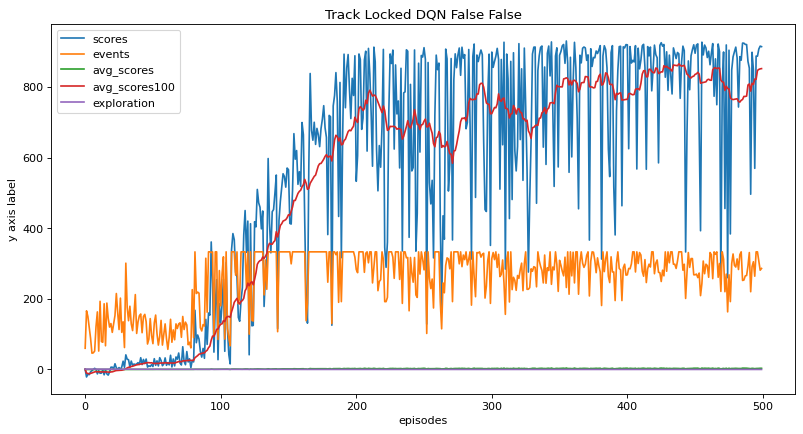

In [ ]:
figure(figsize=(12, 6), dpi=80)
plt.plot(episodes, scores)
plt.plot(episodes, events)
plt.plot(episodes, avg_scores)
plt.plot(episodes, avg_scores20)
plt.plot(episodes, exploration)
plt.xlabel('episodes')
plt.ylabel('y axis label')

plt.title('Track Locked DQN '+str(usedoubleDQN)+' '+str(useDueling))
plt.legend(['scores', 'events', 'avg_scores', 'avg_scores100','exploration'])
plt.show()

In [ ]:
createMovie(bestNet,'bestNet',UseRandomize,UseContinuousControl)

Moviepy - Building video /content/videos/bestNet/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/bestNet/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/bestNet/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/bestNet/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/bestNet/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/bestNet/rl-video-episode-0.mp4


In [ ]:
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))

NameError: ignored

##Double DQN Training without Dueling

In [ ]:
usedoubleDQN=True
useDueling=False

loss_val,scores, episodes,events, avg_scores,avg_scores20,exploration = [],[],[], [],[], [], []

bestScore=-99999;
at=0;
bestNet=copy.deepcopy(policy_net);


for f in range(TotalEpisodes):
    done  = False
    score = 0.0
    tloss = 0.0

    new_state,_=env.reset(options={"randomize": UseRandomize})#,seed=6)


    stackedState=[np.rollaxis(new_state, 2, 0).copy() for i in range(FrameStack)];
    state =torch.from_numpy(np.reshape(np.array(stackedState),(FrameSize*FrameStack,96,96)) ).float().to(device)

    if f % FreezeCounter == 0:
       print("########################################"+str(f)+" of "+str(TotalEpisodes))
       target_net.load_state_dict(policy_net.state_dict())

    if f % SaveAtCounter == 0:
      #torch.save(policy_net.state_dict(), "v2CarRacing_"+str(f)+'_model.ckpt')
       createMovie(policy_net,"CarRacing_"+str(f),UseRandomize,UseContinuousControl)

    resetStatus=0;
    i=0

    for F in range(MaxSteps):
        action = policy_net.getPolicy(state,exploration_threshold)
        reward=0
        for _ in range(ControlSteps):
            new_state, r, done,trunc, info = env.step(action_space[action.item()])
            reward+=r
            i=i+1
            if(done or trunc):
                break
        if reward<0 and i>InitCounter:
            resetStatus=resetStatus+1;
        else:
            resetStatus=0

        stackedState.pop(0)
        stackedState.append(np.rollaxis(new_state, 2, 0).copy())
        new_state=torch.from_numpy(np.reshape(np.array(stackedState),(FrameSize*FrameStack,96,96))).float().to(device)

        score += reward
        if(F<(MaxSteps-1)):
            buffer.store_tuples(state, action, torch.tensor(reward), new_state, torch.tensor(int(done)))

        state = new_state
        trainModel(buffer, usedoubleDQN)


        if(done or trunc or resetStatus>=ResetCounter):
            break
    exploration_threshold= exploration_threshold*exploration_decay if exploration_threshold > exploration_threshold_min else exploration_threshold_min

    if(score>bestScore):
        print("Best EP: ",score," It: ",F*ControlSteps)
        bestScore=score;
        bestNet=copy.deepcopy(policy_net);
        at=f;

    exploration.append(exploration_threshold)
    scores.append(score)
    episodes.append(f)
    events.append(F)
    avg_scores.append(score/F)
    avg_scores20.append(np.mean(scores[-20:]))


torch.save(bestNet.state_dict(), "BestCarRacing_"+str(f)+'_'+str(bestScore)+'_model.ckpt')

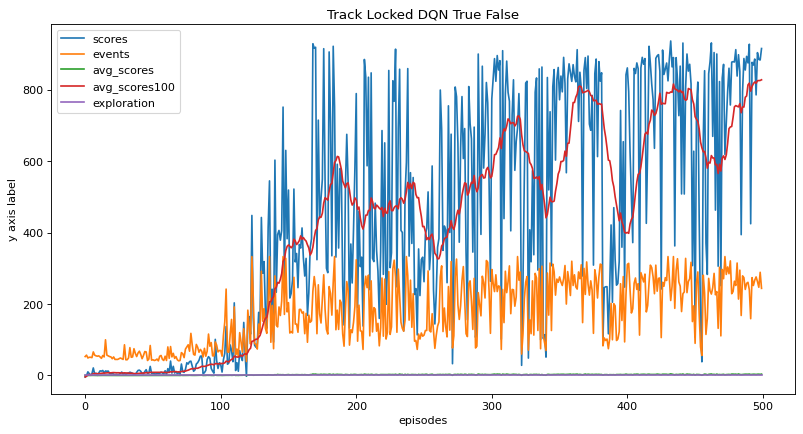

In [ ]:
figure(figsize=(12, 6), dpi=80)
plt.plot(episodes, scores)
plt.plot(episodes, events)
plt.plot(episodes, avg_scores)
plt.plot(episodes, avg_scores20)
plt.plot(episodes, exploration)
plt.xlabel('episodes')
plt.ylabel('y axis label')

plt.title('Track Locked DQN '+str(usedoubleDQN)+' '+str(useDueling))
plt.legend(['scores', 'events', 'avg_scores', 'avg_scores100','exploration'])
plt.show()

In [ ]:
createMovie(bestNet,'bestNet',UseRandomize,UseContinuousControl)

/usr/local/lib/python3.10/dist-packages/gymnasium/wrappers/record_video.py:94: UserWarning: WARN: Overwriting existing videos at /content/videos/bestNet folder (try specifying a different `video_folder` for the `RecordVideo` wrapper if this is not desired)
  logger.warn(


Moviepy - Building video /content/videos/bestNet/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/bestNet/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/bestNet/rl-video-episode-0.mp4
Moviepy - Building video /content/videos/bestNet/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/bestNet/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/bestNet/rl-video-episode-0.mp4


In [ ]:
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))

654.2378698224683
833.7339339339143
595.9651917404002
892.974061433425
839.3017793594141
-35.26493506493587
-69.98851963746252
-80.84516129032221
-59.45925925925995
247.06688102892394


##DQN Training with Dueling



In [ ]:
usedoubleDQN=False
useDueling=True

loss_val,scores, episodes,events, avg_scores,avg_scores20,exploration = [],[],[], [],[], [], []

bestScore=-99999;
at=0;
bestNet=copy.deepcopy(policy_net);


for f in range(TotalEpisodes):
    done  = False
    score = 0.0
    tloss = 0.0

    new_state,_=env.reset(options={"randomize": UseRandomize})#,seed=6)


    stackedState=[np.rollaxis(new_state, 2, 0).copy() for i in range(FrameStack)];
    state =torch.from_numpy(np.reshape(np.array(stackedState),(FrameSize*FrameStack,96,96)) ).float().to(device)

    if f % FreezeCounter == 0:
       print("########################################"+str(f)+" of "+str(TotalEpisodes))
       target_net.load_state_dict(policy_net.state_dict())

    if f % SaveAtCounter == 0:
      #torch.save(policy_net.state_dict(), "v2CarRacing_"+str(f)+'_model.ckpt')
       createMovie(policy_net,"CarRacing_"+str(f),UseRandomize,UseContinuousControl)

    resetStatus=0;
    i=0

    for F in range(MaxSteps):
        action = policy_net.getPolicy(state,exploration_threshold)
        reward=0
        for _ in range(ControlSteps):
            new_state, r, done,trunc, info = env.step(action_space[action.item()])
            reward+=r
            i=i+1
            if(done or trunc):
                break
        if reward<0 and i>InitCounter:
            resetStatus=resetStatus+1;
        else:
            resetStatus=0

        stackedState.pop(0)
        stackedState.append(np.rollaxis(new_state, 2, 0).copy())
        new_state=torch.from_numpy(np.reshape(np.array(stackedState),(FrameSize*FrameStack,96,96))).float().to(device)

        score += reward
        if(F<(MaxSteps-1)):
            buffer.store_tuples(state, action, torch.tensor(reward), new_state, torch.tensor(int(done)))

        state = new_state
        trainModel(buffer, usedoubleDQN)


        if(done or trunc or resetStatus>=ResetCounter):
            break
    exploration_threshold= exploration_threshold*exploration_decay if exploration_threshold > exploration_threshold_min else exploration_threshold_min

    if(score>bestScore):
        print("Best EP: ",score," It: ",F*ControlSteps)
        bestScore=score;
        bestNet=copy.deepcopy(policy_net);
        at=f;

    exploration.append(exploration_threshold)
    scores.append(score)
    episodes.append(f)
    events.append(F)
    avg_scores.append(score/F)
    avg_scores20.append(np.mean(scores[-20:]))


torch.save(bestNet.state_dict(), "BestCarRacing_"+str(f)+'_'+str(bestScore)+'_model.ckpt')

########################################0 of 500
Moviepy - Building video /content/videos/CarRacing_0/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_0/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_0/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_0/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_0/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_0/rl-video-episode-0.mp4


Best EP:  2.759105431309979  It:  225
Best EP:  35.945323741006945  It:  321
########################################5 of 500
########################################10 of 500
Best EP:  48.53333333333293  It:  345
########################################15 of 500
########################################20 of 500
########################################25 of 500
########################################30 of 500
########################################35 of 500
########################################40 of 500
Best EP:  52.228070175438155  It:  387
########################################45 of 500
########################################50 of 500
Moviepy - Building video /content/videos/CarRacing_50/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_50/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_50/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_50/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_50/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_50/rl-video-episode-0.mp4


########################################55 of 500
########################################60 of 500
Best EP:  55.665822784809606  It:  453
Best EP:  146.15503355704996  It:  918
########################################65 of 500
Best EP:  242.2632411067227  It:  855
########################################70 of 500
########################################75 of 500
########################################80 of 500
Best EP:  252.58531468531558  It:  618
########################################85 of 500
########################################90 of 500
Best EP:  358.61428571428036  It:  768
Best EP:  365.63741007193977  It:  873
########################################95 of 500
Best EP:  476.5124555160074  It:  999
########################################100 of 500
Moviepy - Building video /content/videos/CarRacing_100/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_100/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_100/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_100/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_100/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_100/rl-video-episode-0.mp4


########################################105 of 500
Best EP:  657.6923076922931  It:  999
########################################110 of 500
########################################115 of 500
########################################120 of 500
########################################125 of 500
########################################130 of 500
Best EP:  692.8085889570459  It:  891
########################################135 of 500
Best EP:  807.2164948453425  It:  999
########################################140 of 500
Best EP:  859.929520295192  It:  918
########################################145 of 500
########################################150 of 500
Moviepy - Building video /content/videos/CarRacing_150/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_150/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_150/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_150/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_150/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_150/rl-video-episode-0.mp4


########################################155 of 500
Best EP:  863.5545454545306  It:  816
########################################160 of 500
########################################165 of 500
########################################170 of 500
########################################175 of 500
########################################180 of 500
########################################185 of 500
########################################190 of 500
########################################195 of 500
########################################200 of 500
Moviepy - Building video /content/videos/CarRacing_200/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_200/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_200/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_200/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_200/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_200/rl-video-episode-0.mp4


########################################205 of 500
########################################210 of 500
########################################215 of 500
########################################220 of 500
########################################225 of 500
########################################230 of 500
########################################235 of 500
########################################240 of 500
########################################245 of 500
########################################250 of 500
Moviepy - Building video /content/videos/CarRacing_250/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_250/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_250/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_250/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_250/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_250/rl-video-episode-0.mp4


########################################255 of 500
########################################260 of 500
########################################265 of 500
Best EP:  902.9695652173795  It:  576
########################################270 of 500
########################################275 of 500
########################################280 of 500
########################################285 of 500
########################################290 of 500
########################################295 of 500
########################################300 of 500
Moviepy - Building video /content/videos/CarRacing_300/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_300/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_300/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_300/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_300/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_300/rl-video-episode-0.mp4


########################################305 of 500
Best EP:  905.2715953307318  It:  633
########################################310 of 500
########################################315 of 500
########################################320 of 500
########################################325 of 500
########################################330 of 500
Best EP:  922.9720930232509  It:  651
########################################335 of 500
########################################340 of 500
########################################345 of 500
########################################350 of 500
Moviepy - Building video /content/videos/CarRacing_350/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_350/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_350/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_350/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_350/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_350/rl-video-episode-0.mp4


########################################355 of 500
########################################360 of 500
########################################365 of 500
########################################370 of 500
########################################375 of 500
########################################380 of 500
########################################385 of 500
Best EP:  923.7528301886721  It:  684
########################################390 of 500
########################################395 of 500
########################################400 of 500
Moviepy - Building video /content/videos/CarRacing_400/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_400/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_400/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_400/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_400/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_400/rl-video-episode-0.mp4


########################################405 of 500
########################################410 of 500
########################################415 of 500
########################################420 of 500
########################################425 of 500
########################################430 of 500
Best EP:  934.1999999999848  It:  657
########################################435 of 500
########################################440 of 500
Best EP:  938.9999999999909  It:  609
########################################445 of 500
########################################450 of 500
Moviepy - Building video /content/videos/CarRacing_450/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_450/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_450/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_450/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_450/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_450/rl-video-episode-0.mp4


########################################455 of 500
########################################460 of 500
########################################465 of 500
########################################470 of 500
########################################475 of 500
########################################480 of 500
########################################485 of 500
########################################490 of 500
########################################495 of 500


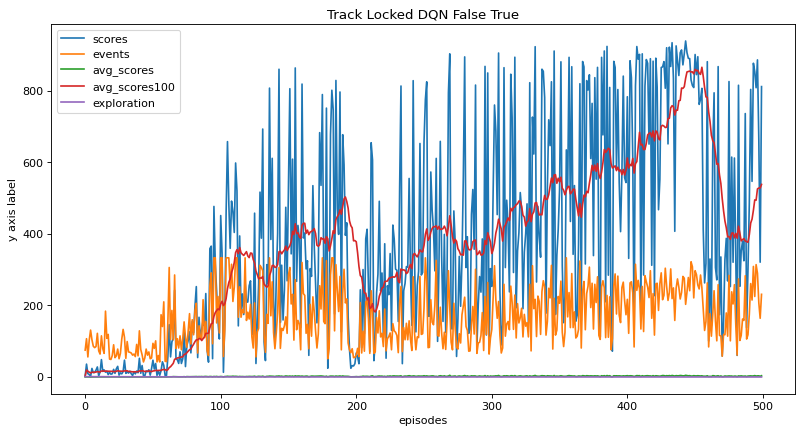

In [ ]:
figure(figsize=(12, 6), dpi=80)
plt.plot(episodes, scores)
plt.plot(episodes, events)
plt.plot(episodes, avg_scores)
plt.plot(episodes, avg_scores20)
plt.plot(episodes, exploration)
plt.xlabel('episodes')
plt.ylabel('y axis label')

plt.title('Track Locked DQN '+str(usedoubleDQN)+' '+str(useDueling))
plt.legend(['scores', 'events', 'avg_scores', 'avg_scores100','exploration'])
plt.show()

In [ ]:
createMovie(bestNet,'bestNet',UseRandomize,UseContinuousControl)

Moviepy - Building video /content/videos/bestNet/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/bestNet/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/bestNet/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/bestNet/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/bestNet/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/bestNet/rl-video-episode-0.mp4


In [ ]:
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))

844.0724458204202
857.6947368420846
896.0264150943251
850.1311258278013
942.3999999999961
-56.132203389830934
-82.8388888888884
23.436363636363467
-80.66874999999965
-21.908185053380574


---

Train each model in continuous and discrete modes, compare the results between each model and each
control modality --> IS ALSO MISSING OR?

---

Discuss the effects of the Deep Q-learning hyperparameters on the reported performances; --> DIDNT experiemnt with those either or?

---

Select the best performing method (from any control modality) and retrain it using UseRandomize=True, discuss the obtained results

In [ ]:
loss_val,scores, episodes,events, avg_scores,avg_scores20,exploration = [],[],[], [],[], [], []

bestScore=-99999;
at=0;
bestNet=copy.deepcopy(policy_net);


for f in range(TotalEpisodes):
    done  = False
    score = 0.0
    tloss = 0.0

    new_state,_=env.reset(options={"randomize": UseRandomize})#,seed=6)


    stackedState=[np.rollaxis(new_state, 2, 0).copy() for i in range(FrameStack)];
    state =torch.from_numpy(np.reshape(np.array(stackedState),(FrameSize*FrameStack,96,96)) ).float().to(device)

    if f % FreezeCounter == 0:
       print("########################################"+str(f)+" of "+str(TotalEpisodes))
       target_net.load_state_dict(policy_net.state_dict())

    if f % SaveAtCounter == 0:
      #torch.save(policy_net.state_dict(), "v2CarRacing_"+str(f)+'_model.ckpt')
       createMovie(policy_net,"CarRacing_"+str(f),UseRandomize,UseContinuousControl)

    resetStatus=0;
    i=0

    for F in range(MaxSteps):
        action = policy_net.getPolicy(state,exploration_threshold)
        reward=0
        for _ in range(ControlSteps):
            new_state, r, done,trunc, info = env.step(action_space[action.item()])
            reward+=r
            i=i+1
            if(done or trunc):
                break
        if reward<0 and i>InitCounter:
            resetStatus=resetStatus+1;
        else:
            resetStatus=0

        stackedState.pop(0)
        stackedState.append(np.rollaxis(new_state, 2, 0).copy())
        new_state=torch.from_numpy(np.reshape(np.array(stackedState),(FrameSize*FrameStack,96,96))).float().to(device)

        score += reward
        if(F<(MaxSteps-1)):
            buffer.store_tuples(state, action, torch.tensor(reward), new_state, torch.tensor(int(done)))

        state = new_state
        trainModel(buffer, usedoubleDQN)


        if(done or trunc or resetStatus>=ResetCounter):
            break
    exploration_threshold= exploration_threshold*exploration_decay if exploration_threshold > exploration_threshold_min else exploration_threshold_min

    if(score>bestScore):
        print("Best EP: ",score," It: ",F*ControlSteps)
        bestScore=score;
        bestNet=copy.deepcopy(policy_net);
        at=f;

    exploration.append(exploration_threshold)
    scores.append(score)
    episodes.append(f)
    events.append(F)
    avg_scores.append(score/F)
    avg_scores20.append(np.mean(scores[-20:]))


torch.save(bestNet.state_dict(), "BestCarRacing_"+str(f)+'_'+str(bestScore)+'_model.ckpt')

########################################0 of 500
Moviepy - Building video /content/videos/CarRacing_0/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_0/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_0/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_0/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_0/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_0/rl-video-episode-0.mp4


Best EP:  22.459477124182868  It:  426
########################################5 of 500
Best EP:  25.11392405063244  It:  537
Best EP:  35.10137457044632  It:  402
########################################10 of 500
Best EP:  44.29999999999961  It:  354
########################################15 of 500
########################################20 of 500
Best EP:  103.07338129496534  It:  549
########################################25 of 500
########################################30 of 500
########################################35 of 500
########################################40 of 500
########################################45 of 500
########################################50 of 500
Moviepy - Building video /content/videos/CarRacing_50/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_50/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_50/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_50/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_50/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_50/rl-video-episode-0.mp4


########################################55 of 500
########################################60 of 500
########################################65 of 500
########################################70 of 500
########################################75 of 500
########################################80 of 500
########################################85 of 500
########################################90 of 500
########################################95 of 500
Best EP:  138.20236220472603  It:  426
########################################100 of 500
Moviepy - Building video /content/videos/CarRacing_100/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_100/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_100/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_100/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_100/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_100/rl-video-episode-0.mp4


########################################105 of 500
########################################110 of 500
Best EP:  147.36430868167298  It:  324
########################################115 of 500
########################################120 of 500
########################################125 of 500
########################################130 of 500
Best EP:  202.9724137931055  It:  519
########################################135 of 500
Best EP:  289.27042253520995  It:  555
########################################140 of 500
########################################145 of 500
########################################150 of 500
Moviepy - Building video /content/videos/CarRacing_150/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_150/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_150/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_150/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_150/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_150/rl-video-episode-0.mp4


########################################155 of 500
########################################160 of 500
Best EP:  540.9395973154278  It:  999
########################################165 of 500
########################################170 of 500
########################################175 of 500
########################################180 of 500
########################################185 of 500
########################################190 of 500
########################################195 of 500
########################################200 of 500
Moviepy - Building video /content/videos/CarRacing_200/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_200/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_200/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_200/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_200/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_200/rl-video-episode-0.mp4


########################################205 of 500
########################################210 of 500
########################################215 of 500
########################################220 of 500
########################################225 of 500
########################################230 of 500
########################################235 of 500
########################################240 of 500
########################################245 of 500
########################################250 of 500
Moviepy - Building video /content/videos/CarRacing_250/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_250/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_250/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_250/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_250/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_250/rl-video-episode-0.mp4


########################################255 of 500
########################################260 of 500
########################################265 of 500
########################################270 of 500
########################################275 of 500
########################################280 of 500
########################################285 of 500
########################################290 of 500
########################################295 of 500
########################################300 of 500
Moviepy - Building video /content/videos/CarRacing_300/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_300/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_300/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_300/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_300/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_300/rl-video-episode-0.mp4


########################################305 of 500
########################################310 of 500
########################################315 of 500
########################################320 of 500
########################################325 of 500
Best EP:  563.7142857142752  It:  717
########################################330 of 500
########################################335 of 500
########################################340 of 500
########################################345 of 500
########################################350 of 500
Moviepy - Building video /content/videos/CarRacing_350/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_350/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_350/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_350/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_350/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_350/rl-video-episode-0.mp4


########################################355 of 500
########################################360 of 500
########################################365 of 500
########################################370 of 500
########################################375 of 500
########################################380 of 500
########################################385 of 500
########################################390 of 500
########################################395 of 500
########################################400 of 500
Moviepy - Building video /content/videos/CarRacing_400/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_400/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_400/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_400/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_400/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_400/rl-video-episode-0.mp4


########################################405 of 500
########################################410 of 500
########################################415 of 500
########################################420 of 500
########################################425 of 500
########################################430 of 500
########################################435 of 500
########################################440 of 500
########################################445 of 500
########################################450 of 500
Moviepy - Building video /content/videos/CarRacing_450/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_450/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_450/rl-video-episode-0.mp4


Moviepy - Building video /content/videos/CarRacing_450/rl-video-episode-0.mp4.
Moviepy - Writing video /content/videos/CarRacing_450/rl-video-episode-0.mp4



Moviepy - Done !
Moviepy - video ready /content/videos/CarRacing_450/rl-video-episode-0.mp4


########################################455 of 500
########################################460 of 500
########################################465 of 500
########################################470 of 500
########################################475 of 500
########################################480 of 500
########################################485 of 500
Best EP:  836.6030651340907  It:  903
########################################490 of 500
########################################495 of 500


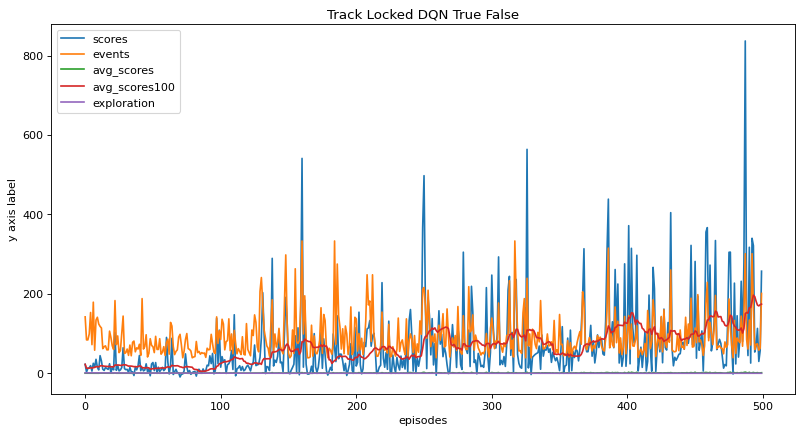

In [ ]:
figure(figsize=(12, 6), dpi=80)
plt.plot(episodes, scores)
plt.plot(episodes, events)
plt.plot(episodes, avg_scores)
plt.plot(episodes, avg_scores20)
plt.plot(episodes, exploration)
plt.xlabel('episodes')
plt.ylabel('y axis label')

plt.title('Track Locked DQN '+str(usedoubleDQN)+' '+str(useDueling))
plt.legend(['scores', 'events', 'avg_scores', 'avg_scores100','exploration'])
plt.show()

In [ ]:
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',False,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))
print(evaluate(bestNet,'bestNet',True,UseContinuousControl))

504.5297297297236
462.71390728476024
81.91920529801806
503.57358490564775
319.6717948717849
272.2832214764983
455.73220338981514
25.72592592592494
484.4645367412049
47.34098360656137
